In [1]:
import os
import scanpy
import numpy as np
from matplotlib import pyplot as plt

plt.rcParams['pdf.use14corefonts'] = True

In [2]:
ori_adata = scanpy.read_h5ad('scanpy_objects/normalized_adata.h5ad')
ori_adata

AnnData object with n_obs × n_vars = 71333 × 989
    obs: 'BIOTURING_700HVG_leiden_on_scvi_0.5', 'BIOTURING_700HVG_leiden_on_scvi_1.0', 'BIOTURING_700HVG_leiden_on_scvi_1.5', 'BioTuring louvain (on scvi-vae)', 'BioTuring_Number of genes', 'BioTuring_Number of mRNA transcripts', 'BioTuring_Percentage of negative controls', 'BioTuring_TP_tissue_structure', 'BioTuring_bioturing_1st_anno', 'BioTuring_cell type (old)', 'BioTuring_label', 'BioTuring_manual+prediction(ML)_celltype', 'BioTuring_manual_cell type_final', 'BioTuring_sup$clust', 'Kidney-specific model (version 1)', 'NANOSTRING_Area', 'NANOSTRING_AspectRatio', 'NANOSTRING_Commercial', 'NANOSTRING_Diversity', 'NANOSTRING_Height', 'NANOSTRING_ISH.concentration', 'NANOSTRING_Lees L Cluster 1', 'NANOSTRING_Lees L Cluster 1 truncated', 'NANOSTRING_Lees L Cluster 2', 'NANOSTRING_Lees L Cluster 2 truncated', 'NANOSTRING_Lees L Cluster 3', 'NANOSTRING_Lees L Cluster 3 truncated', 'NANOSTRING_Lees L Cluster 4', 'NANOSTRING_Lees L Cluster 4 

In [3]:
for col in ori_adata.obs:
    try:
        ori_adata.obs[col] = pd.Categorical(
            values=ori_adata.obs[col], categories=ori_adata.obs[col].cat.remove_unused_categories().cat.categories.tolist(), ordered=True
        )
    except:
        continue

In [4]:
ori_adata

AnnData object with n_obs × n_vars = 71333 × 989
    obs: 'BIOTURING_700HVG_leiden_on_scvi_0.5', 'BIOTURING_700HVG_leiden_on_scvi_1.0', 'BIOTURING_700HVG_leiden_on_scvi_1.5', 'BioTuring louvain (on scvi-vae)', 'BioTuring_Number of genes', 'BioTuring_Number of mRNA transcripts', 'BioTuring_Percentage of negative controls', 'BioTuring_TP_tissue_structure', 'BioTuring_bioturing_1st_anno', 'BioTuring_cell type (old)', 'BioTuring_label', 'BioTuring_manual+prediction(ML)_celltype', 'BioTuring_manual_cell type_final', 'BioTuring_sup$clust', 'Kidney-specific model (version 1)', 'NANOSTRING_Area', 'NANOSTRING_AspectRatio', 'NANOSTRING_Commercial', 'NANOSTRING_Diversity', 'NANOSTRING_Height', 'NANOSTRING_ISH.concentration', 'NANOSTRING_Lees L Cluster 1', 'NANOSTRING_Lees L Cluster 1 truncated', 'NANOSTRING_Lees L Cluster 2', 'NANOSTRING_Lees L Cluster 2 truncated', 'NANOSTRING_Lees L Cluster 3', 'NANOSTRING_Lees L Cluster 3 truncated', 'NANOSTRING_Lees L Cluster 4', 'NANOSTRING_Lees L Cluster 4 

In [5]:
import numpy as np
np.unique(ori_adata.obs['NANOSTRING_fovAnnotation'].values)

array(['Ctrl_1', 'Ctrl_2', 'DKD_1-3', 'DKD_2-3'], dtype=object)

In [6]:
ori_adata.obs['simplified_bioturing_celltypes'].unique().tolist()

['Unassigned',
 'Intercalated cell',
 'Endothelial cell',
 'Connecting tubule',
 'Fibroblast',
 'Proximal tubule',
 'Loop of Henle',
 'MNP_1',
 'T cell',
 'Distal tubule',
 'Principal cell',
 'MNP_2',
 'B cell / Plasma cell',
 'Podocyte',
 'Myofibroblast']

In [7]:
ori_adata.obs['NANOSTRING_simplified_celltypes'].unique().tolist()

['Proximal tubule',
 'Principal cell',
 'Epithelial progenitor cell',
 'Connecting tubule',
 'T cell',
 'Fibroblast',
 'Endothelial cell',
 'MNP-a / MNP-b / MNP-c',
 'Myofibroblast',
 'Intercalated cell',
 'Podocyte',
 'Plasmacytoid dendritic cell',
 'Pelvic epithelium',
 'B cell',
 'Loop of Henle',
 'NK cell',
 'Mast cell',
 'MNP-d/Tissue macrophage']

In [8]:
bioturing_pallete = np.array([
"#1f77b4",
"#ff7f0e",
"#2ca02c",
"#d62728",
"#9467bd",
"#8c564b",
"#e377c2",
"#bcbd22",
"#17becf",
"#aec7e8",
"#ffbb78",
"#98df8a",
"#ff9896",
"#c5b0d5",
"#c49c94",
"#f7b6d2",
"#c7c7c7",
"#dbdb8d",
"#9edae5",
"#B4B4B4",
])

In [9]:
bioturing_color = [
    'Endothelial cell',
    'Loop of Henle',
    'Podocyte',
    'Proximal tubule',
    'Distal tubule',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell / Plasma cell',
    'T cell',
    'MNP_1',
    'MNP_2',
    'Fibroblast',
    'Myofibroblast',
    'Unassigned'
]

nanostring_colors = [
    'Endothelial cell',
    'Loop of Henle',
    'Podocyte',
    'Proximal tubule',
    'Epithelial progenitor cell',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell',
    'T cell',
    'MNP-a / MNP-b / MNP-c',
    'MNP-d/Tissue macrophage',
    'Fibroblast',
    'Myofibroblast',
    'NK cell',
    'Mast cell',
    'Pelvic epithelium',
    'Plasmacytoid dendritic cell',
]
bioturing_color = {bioturing_color[i]:bioturing_pallete[i] for i in range(len(bioturing_color))}
bioturing_color['Unassigned'] = bioturing_pallete[-1]
nanostring_colors = {nanostring_colors[i]:bioturing_pallete[i] for i in range(len(nanostring_colors))}

In [10]:
scanpy.set_figure_params(dpi=150, dpi_save=1000, figsize=(10, 10))

In [11]:
import pandas as pd
ori_adata.obs['simplified_bioturing_celltypes'] = pd.Categorical(
    values=ori_adata.obs['simplified_bioturing_celltypes'], categories=list(bioturing_color.keys()), ordered=True
)

In [12]:
tmp_arr = []
for i in ori_adata.obs['simplified_bioturing_celltypes'].cat.categories:
	tmp_arr.append(bioturing_color[i])

ori_adata.uns['simplified_bioturing_celltypes_colors'] = np.array(tmp_arr)

In [13]:
ori_adata.obs['NANOSTRING_simplified_celltypes'].cat.categories

Index(['Unassigned', 'B cell', 'Connecting tubule', 'Endothelial cell',
       'Epithelial progenitor cell', 'Fibroblast', 'Intercalated cell',
       'Loop of Henle', 'MNP-a / MNP-b / MNP-c', 'MNP-d/Tissue macrophage',
       'Mast cell', 'Myofibroblast', 'NK cell', 'Pelvic epithelium',
       'Plasmacytoid dendritic cell', 'Podocyte', 'Principal cell',
       'Proximal tubule', 'T cell'],
      dtype='object')

In [14]:
ori_adata.obs['simplified_bioturing_celltypes'].cat.categories

Index(['Endothelial cell', 'Loop of Henle', 'Podocyte', 'Proximal tubule',
       'Distal tubule', 'Connecting tubule', 'Intercalated cell',
       'Principal cell', 'B cell / Plasma cell', 'T cell', 'MNP_1', 'MNP_2',
       'Fibroblast', 'Myofibroblast', 'Unassigned'],
      dtype='object')

In [15]:
ori_adata.obs['NANOSTRING_simplified_celltypes'] = pd.Categorical(
    values=ori_adata.obs['NANOSTRING_simplified_celltypes'], categories=list(nanostring_colors.keys()), ordered=True
)

In [16]:
tmp_arr = []
for i in ori_adata.obs['NANOSTRING_simplified_celltypes'].cat.categories:
	tmp_arr.append(nanostring_colors[i])

ori_adata.uns['NANOSTRING_simplified_celltypes_colors'] = np.array(tmp_arr)

In [17]:
tmp_adata = ori_adata[
	np.isin(ori_adata.obs['simplified_bioturing_celltypes'].values, ['loop of helen ', 'principal cells ', 'distal tubule ', 'intercalated cell ', 'proximal tubule ', 'connecting tubule ']),
	:
]

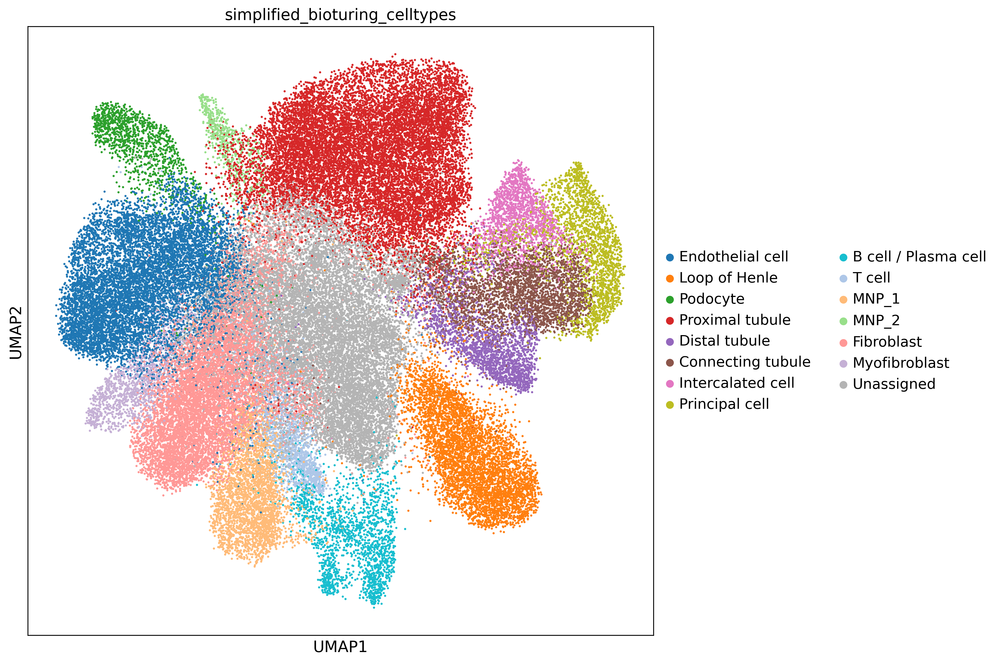

In [28]:
scanpy.pl.umap(ori_adata, color=['simplified_bioturing_celltypes'], s=15, save='_bioturing_all_celltype.png')
scanpy.pl.umap(ori_adata, color=['simplified_bioturing_celltypes'], s=15, save='fig_2b.png')

In [30]:
scanpy.set_figure_params(dpi=150, dpi_save=500, figsize=(10, 10))
scanpy.pl.umap(
    ori_adata, 
    color=['PECAM1', 'NPHS1', 'LRP2', 'SLC26A7'], 
    s=20, 
    use_raw=False, 
    save='fig_2c_1.png',
    show=False
)
scanpy.set_figure_params(dpi=150, dpi_save=1000, figsize=(10, 10))

In [31]:
scanpy.set_figure_params(dpi=150, dpi_save=500, figsize=(10, 10))
scanpy.pl.umap(
    ori_adata, 
    color=['IGHG1', 'SLC12A1', 'SLC12A3', 'AQP3'], 
    s=20, 
    use_raw=False, 
    save='fig_2c_2.png',
    show=False
)
scanpy.set_figure_params(dpi=150, dpi_save=1000, figsize=(10, 10))

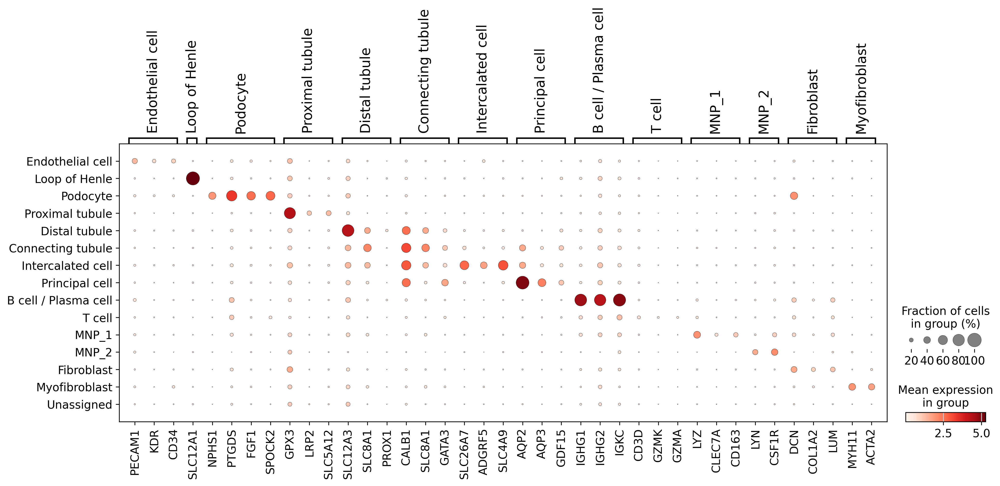

In [33]:
scanpy.pl.dotplot(
    ori_adata,
    groupby='simplified_bioturing_celltypes',
    var_names={
        'Endothelial cell': ['PECAM1', 'KDR', 'CD34'],
        'Loop of Henle': ['SLC12A1'],
        'Podocyte': ['NPHS1', 'PTGDS', 'FGF1', 'SPOCK2'],
        'Proximal tubule': ['GPX3', 'LRP2', 'SLC5A12'],
        'Distal tubule': ['SLC12A3', 'SLC8A1', 'PROX1'],
        'Connecting tubule': ['CALB1', 'SLC8A1', 'GATA3'],
        'Intercalated cell': ['SLC26A7', 'ADGRF5', 'SLC4A9'],
        'Principal cell': ['AQP2', 'AQP3', 'GDF15'],
        'B cell / Plasma cell': ['IGHG1', 'IGHG2', 'IGKC'],
        'T cell': ['CD3D', 'GZMK', 'GZMA'],
        'MNP_1': ['LYZ', 'CLEC7A', 'CD163'],
        'MNP_2': ['LYN', 'CSF1R'],
        'Fibroblast': ['DCN', 'COL1A2', 'LUM'],
        'Myofibroblast': ['MYH11', 'ACTA2'],
    },
    use_raw=False,
    save='fig_2d.png'
)

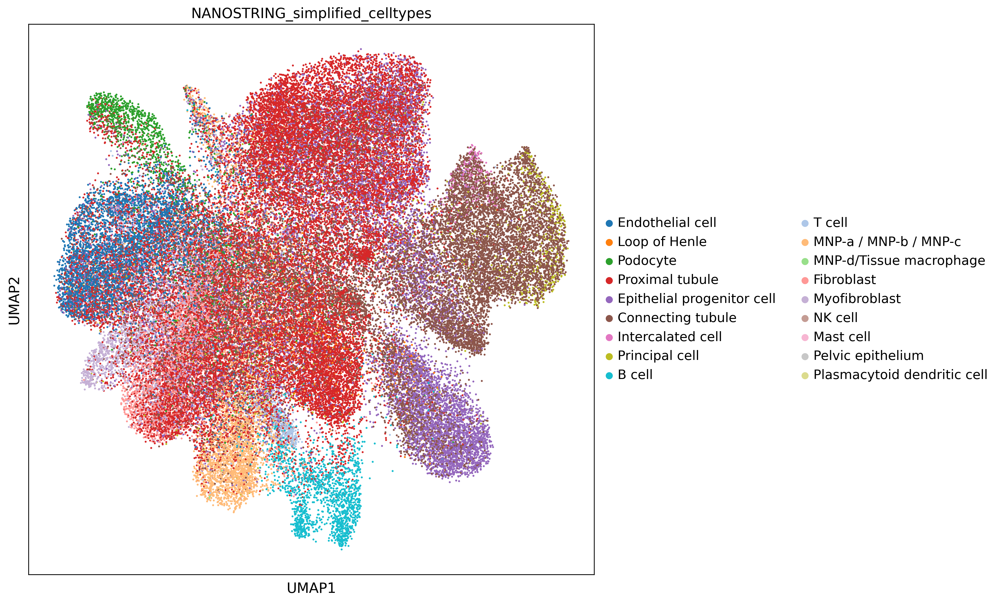

In [52]:
scanpy.pl.umap(ori_adata, color=['NANOSTRING_simplified_celltypes'], s=15, save='_nanostring_all_celltype.png')

In [40]:
ori_adata.obs['NANOSTRING_fovAnnotation'] = ori_adata.obs['NANOSTRING_fovAnnotation'].cat.remove_unused_categories()

In [41]:
ori_adata.obs['NANOSTRING_fovAnnotation'].cat.categories

Index(['Ctrl_1', 'Ctrl_2', 'DKD_1-3', 'DKD_2-3'], dtype='object')

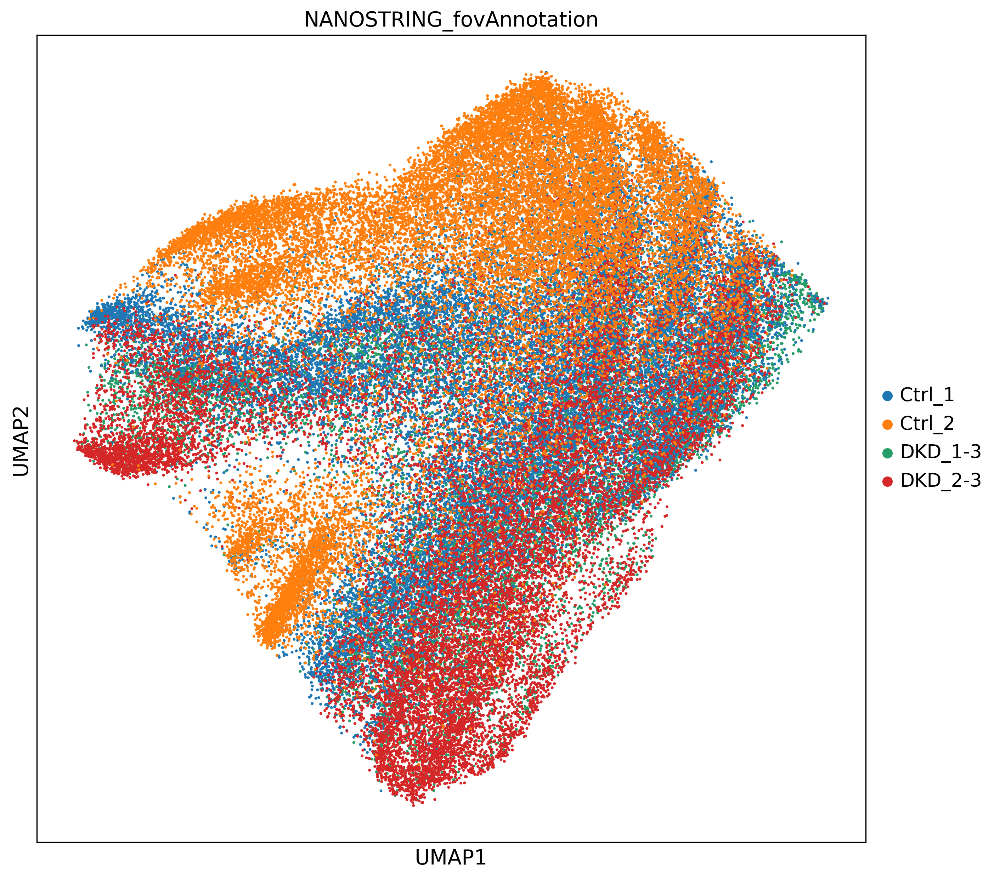

In [42]:
ori_adata.obsm['X_umap'] = ori_adata.obsm['X_umap_(n_neighbors=30)_-_pca_(no_batch_corrected)']
scanpy.pl.umap(ori_adata, color='NANOSTRING_fovAnnotation', s=15, save='fig_2a_1.png')

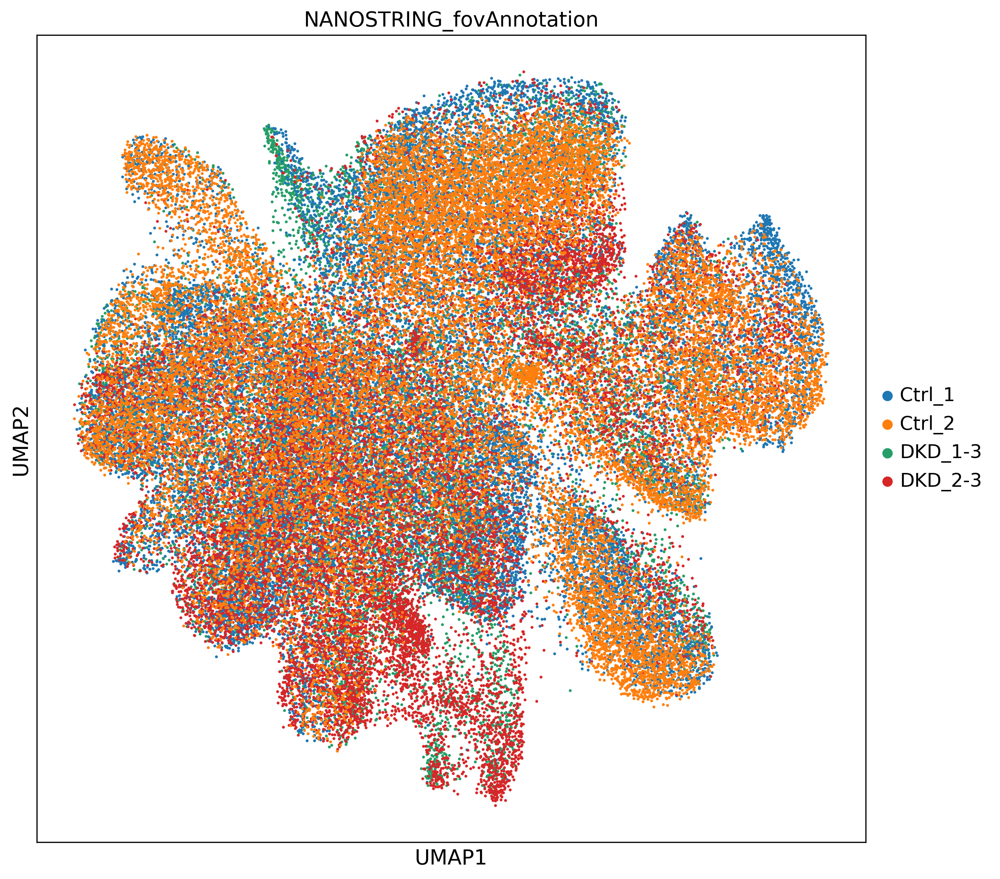

In [43]:
ori_adata.obsm['X_umap'] = ori_adata.obsm['X_scvi_700_hvg_umap_50neighbors']
scanpy.pl.umap(ori_adata, color='NANOSTRING_fovAnnotation', s=15, save='fig_2a_2.png')

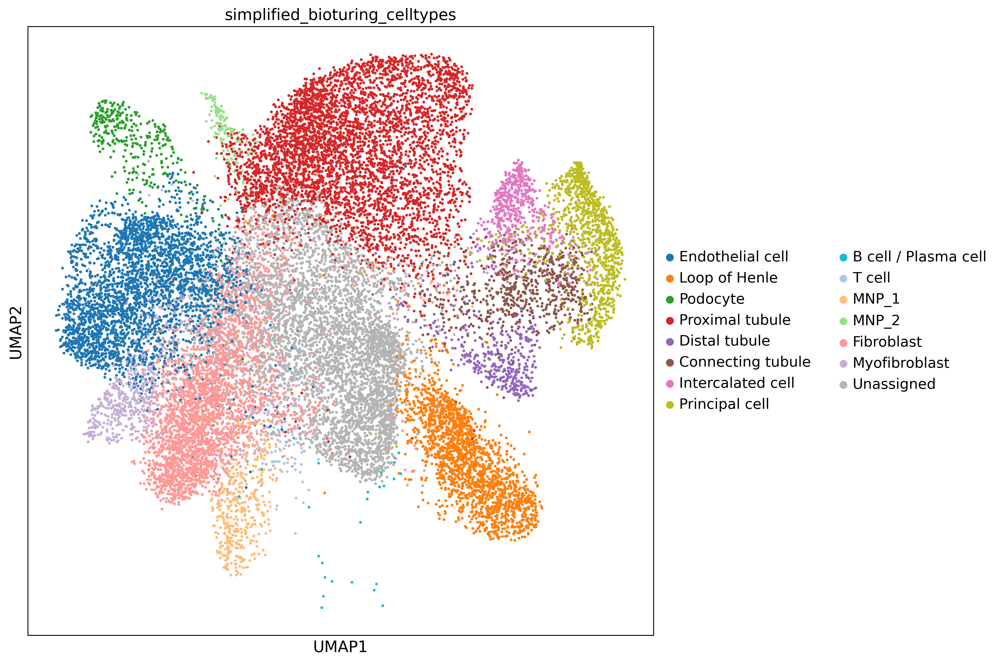

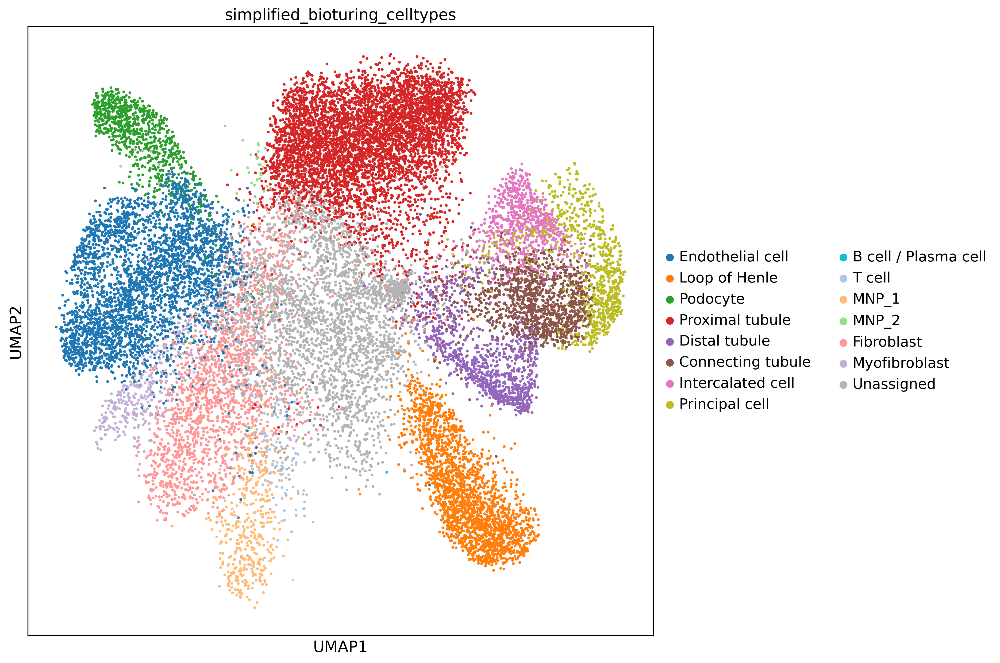

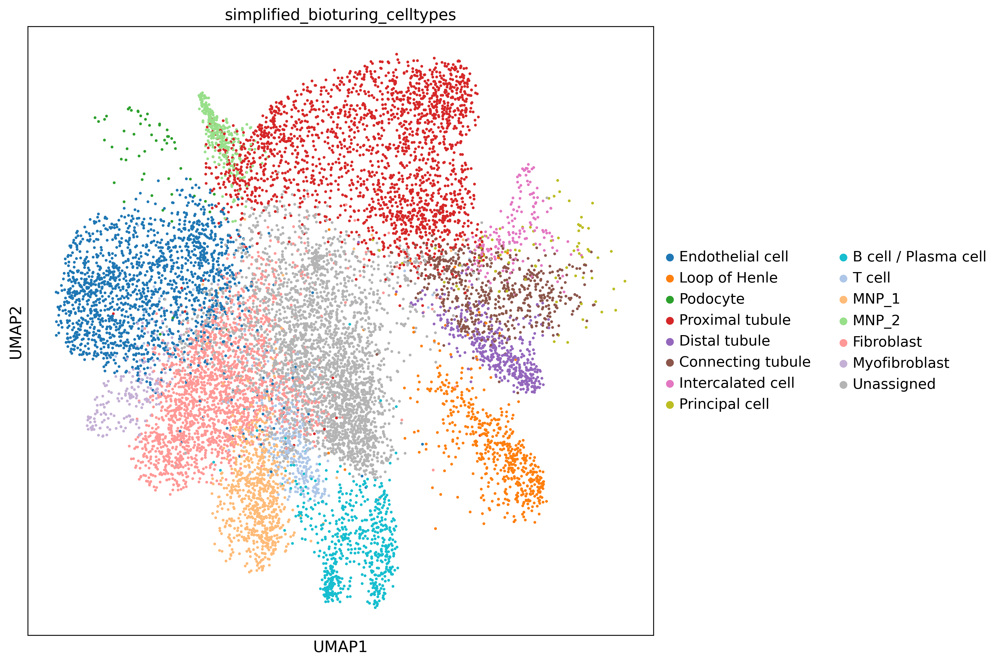

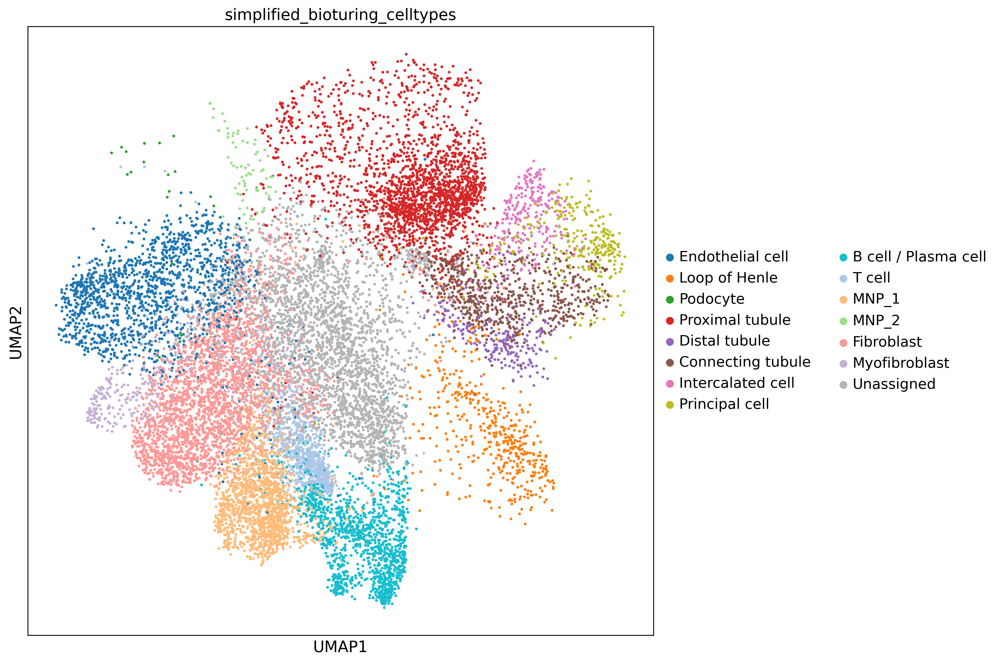

In [69]:
for i in ori_adata.obs['NANOSTRING_fovAnnotation'].cat.categories:
    scanpy.pl.umap(
    	ori_adata[ori_adata.obs['NANOSTRING_fovAnnotation'].values == i],
    	color=['simplified_bioturing_celltypes'], s=25, save='bioturing_{}.png'.format(i)
    )

## QC plots

In [35]:
ori_adata.var["NegCtrl"] = ori_adata.var_names.str.startswith("NegPrb")

In [36]:
raw_exp_adata = ori_adata.copy()
del raw_exp_adata.X
raw_exp_adata.X = ori_adata.layers['raw']

In [37]:
scanpy.pp.calculate_qc_metrics(
    raw_exp_adata, inplace=True, log1p=True
)

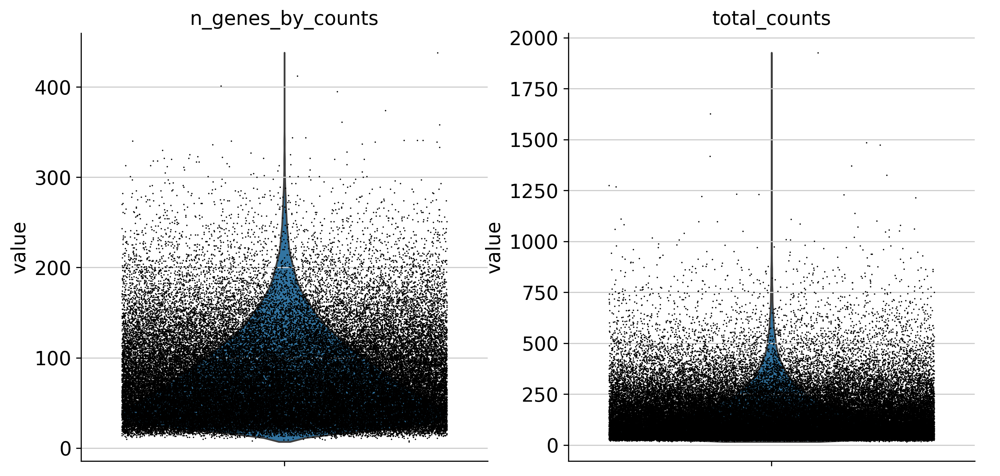

In [53]:
scanpy.pl.violin(
    raw_exp_adata,
    ["n_genes_by_counts", "total_counts"],
    jitter=0.4,
    multi_panel=True,
	save='fig_S1a_12.png'
)

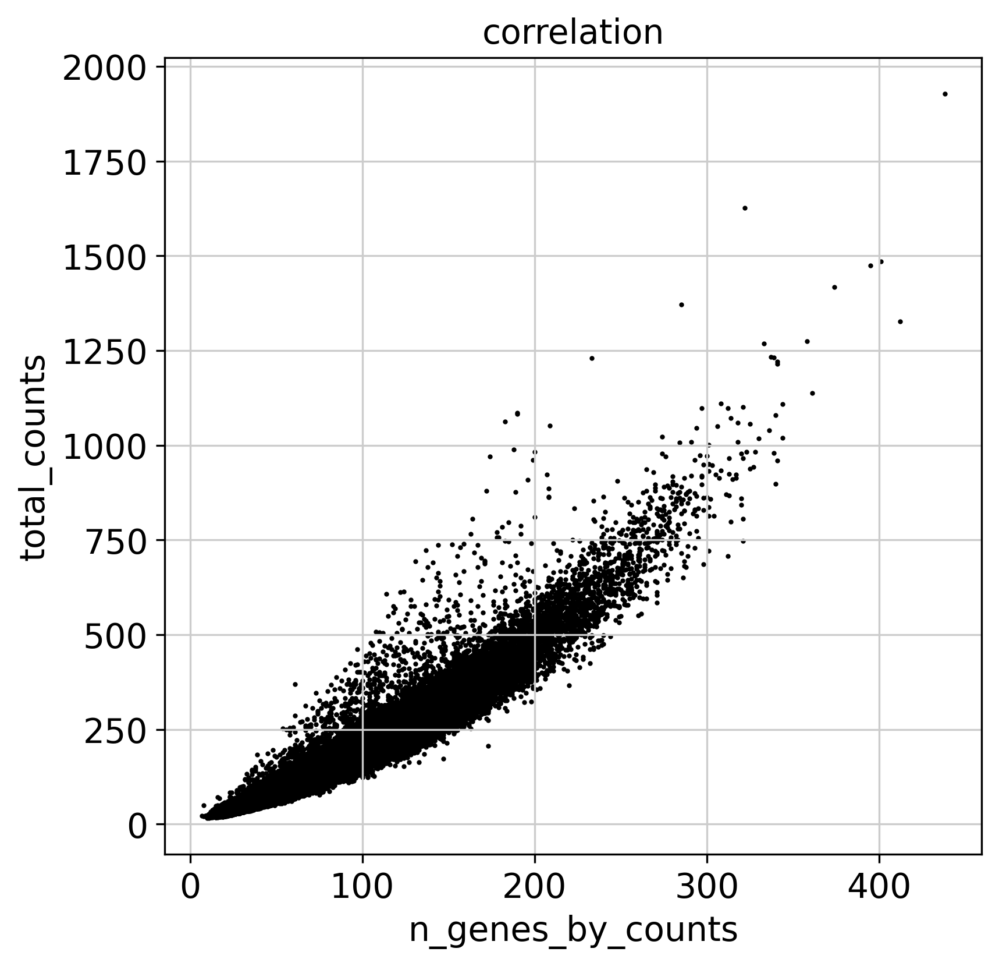

In [55]:
fig, ax = plt.subplots(figsize=(6,6))
ax.scatter(
	y=raw_exp_adata.obs['total_counts'].values,
	x=raw_exp_adata.obs['n_genes_by_counts'].values,
	s=1,
	# c=bioturing_pallete[np.unique(ori_adata.obs['NANOSTRING_fovAnnotation'].values, return_inverse=True)[1]]
	c='black'
)
ax.set_title('correlation')
ax.set_xlabel('n_genes_by_counts')
ax.set_ylabel('total_counts')
plt.savefig('figures/fig_S1a_3.png')
plt.show()

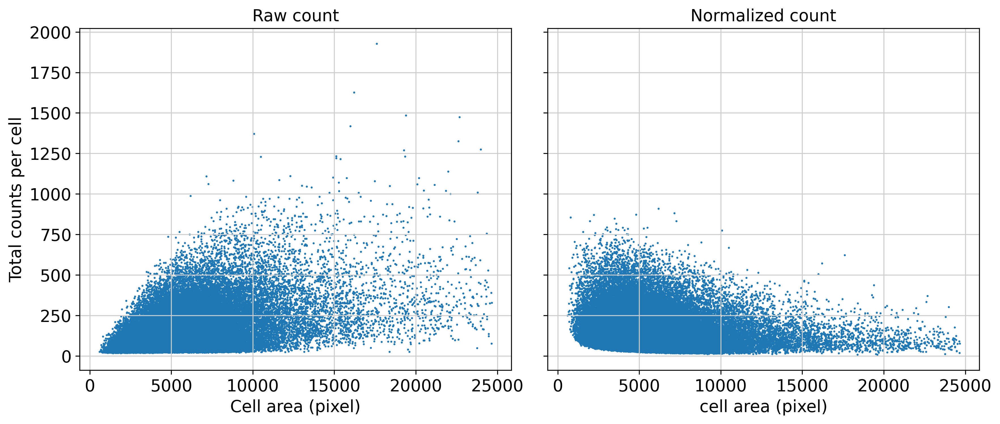

In [59]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,5), sharey=True)
ax[0].scatter(
	y=np.array(ori_adata.layers['raw'].sum(axis=1).reshape(-1))[0],
	x=ori_adata.obs['NANOSTRING_Area'].values,
	s=0.5,
	# c=bioturing_pallete[np.unique(ori_adata.obs['NANOSTRING_fovAnnotation'].values, return_inverse=True)[1]]
)
ax[0].set_ylabel('Total counts per cell')
ax[0].set_xlabel('Cell area (pixel)')
ax[1].scatter(
	y=np.array(ori_adata.X.sum(axis=1).reshape(-1))[0],
	x=ori_adata.obs['NANOSTRING_Area'].values,
	s=0.5,
	# c=bioturing_pallete[np.unique(ori_adata.obs['NANOSTRING_fovAnnotation'].values, return_inverse=True)[1]]
)
# ax[1].set_ylabel('normalized count')
fig.tight_layout()
ax[1].set_xlabel('cell area (pixel)')
ax[0].set_title('Raw count')
ax[1].set_title('Normalized count')
plt.savefig('figures/fig_S1b.png')
plt.show()

## Compare glomerulus cell types composition

In [64]:
ori_adata.obs['BioTuring_TP_tissue_structure'].unique()

['Unassigned', 'glomerulus']
Categories (2, object): ['Unassigned', 'glomerulus']

In [65]:
tmp_df = ori_adata.obs
tmp_df = tmp_df.iloc[
	tmp_df['simplified_bioturing_celltypes'].values != 'Unassigned',
	:
]
tmp_df = tmp_df.iloc[
	tmp_df['BioTuring_TP_tissue_structure'].values == 'glomerulus',
	:
]

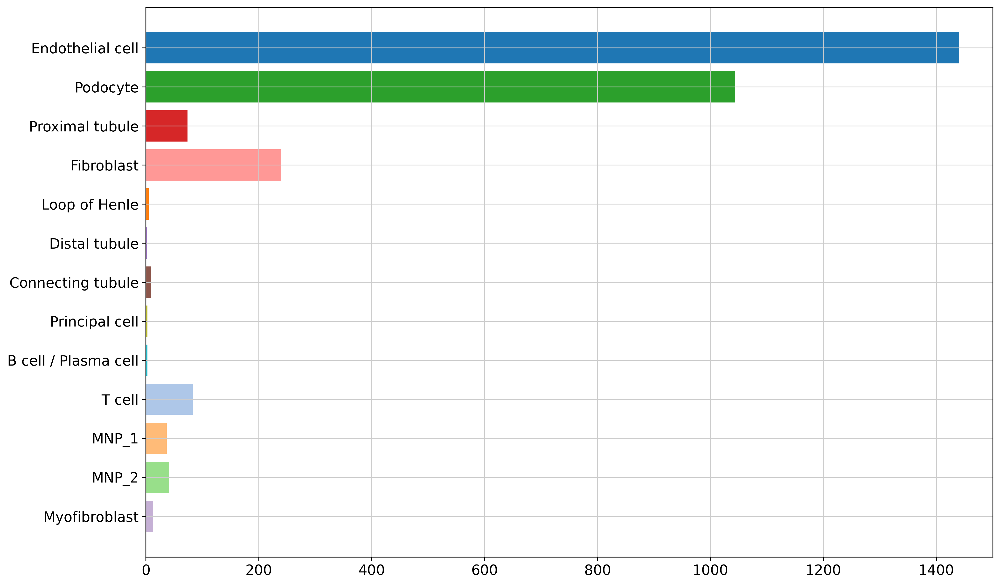

In [66]:
ct_label, ct_count  = np.unique(tmp_df['simplified_bioturing_celltypes'].values, return_counts=True)
ct_dct = dict(zip(ct_label, ct_count))
orders = [i for i in [
    'Endothelial cell',
    'Podocyte',
    'Proximal tubule',
    'Fibroblast',
    'Loop of Henle',
    'Distal tubule',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell / Plasma cell',
    'T cell',
    'MNP_1',
    'MNP_2',
    'Myofibroblast',
] if i in ct_dct][::-1]

fig, ax = plt.subplots(figsize=(15, 10))
ax = plt.barh(orders, [ct_dct[i] for i in orders], color=[bioturing_color[i] for i in orders])
plt.xlim(0, 1500)
plt.savefig('figures/fig_3a.png')
plt.show()

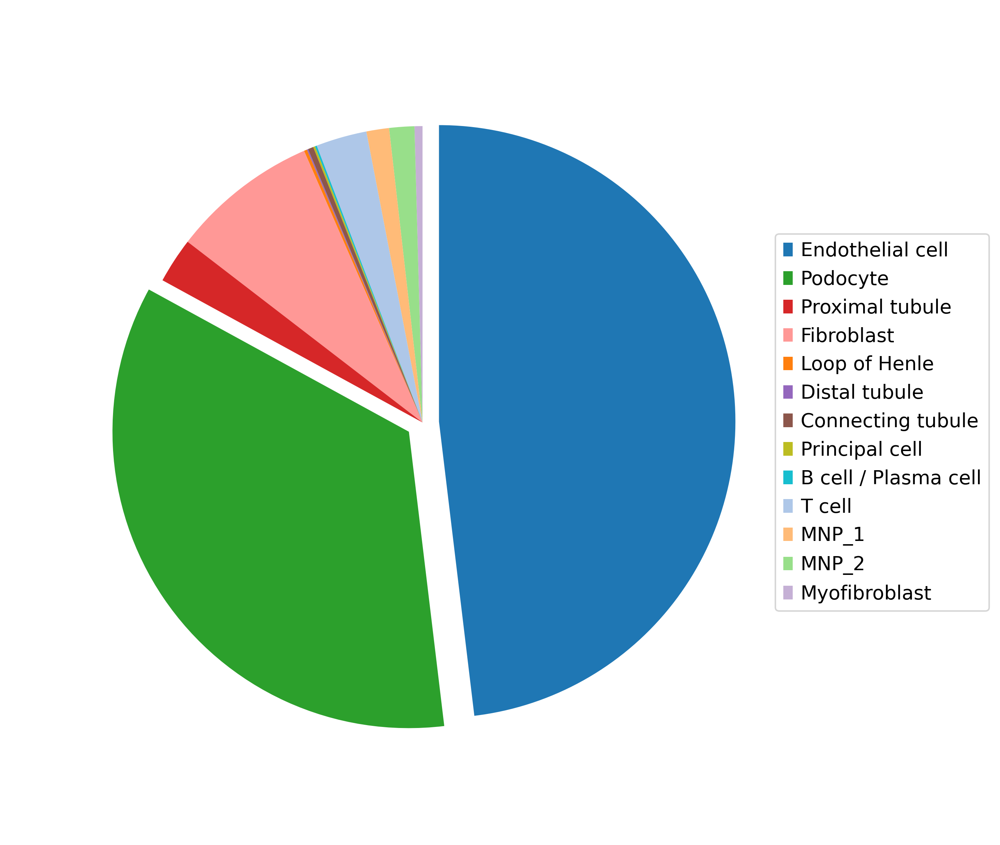

In [68]:
ct_label, ct_count  = np.unique(tmp_df['simplified_bioturing_celltypes'].values, return_counts=True)
ct_dct = dict(zip(ct_label, ct_count))
orders = [i for i in [
    'Endothelial cell',
    'Podocyte',
    'Proximal tubule',
    'Fibroblast',
    'Loop of Henle',
    'Distal tubule',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell / Plasma cell',
    'T cell',
    'MNP_1',
    'MNP_2',
    'Myofibroblast',
] if i in ct_dct][::-1]

fig, ax = plt.subplots(figsize=(20, 10))
myexplode = [0] * len(ct_label)
myexplode[-1] = 0.05
myexplode[-2] = 0.05
ax = plt.pie([ct_dct[i] for i in orders], labels=None, startangle=90, explode=myexplode, colors=[bioturing_color[i] for i in orders], radius=0.9)
plt.legend(
    loc="center right", 
    # title="BioTuring Cell Types", 
    labels=orders, 
    reverse=True, 
    bbox_to_anchor=(1.2, 0.5)
)
plt.savefig('figures/fig_4a.png')
plt.show()

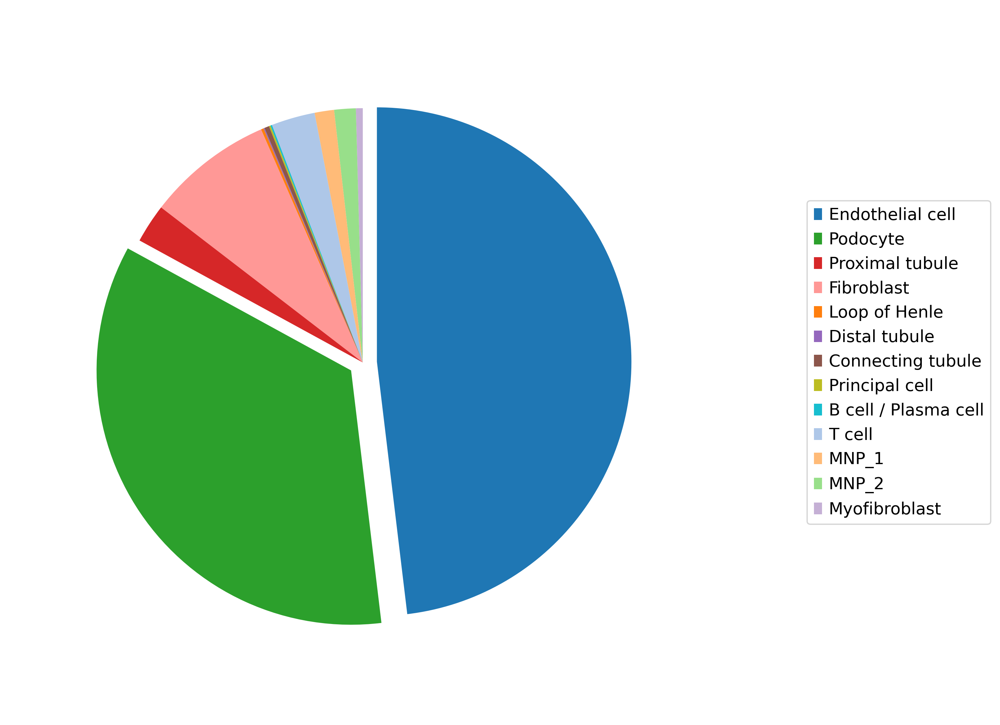

In [68]:
ct_label, ct_count  = np.unique(tmp_df['simplified_bioturing_celltypes'].values, return_counts=True)
ct_dct = dict(zip(ct_label, ct_count))
orders = [i for i in [
    'Endothelial cell',
    'Podocyte',
    'Proximal tubule',
    'Fibroblast',
    'Loop of Henle',
    'Distal tubule',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell / Plasma cell',
    'T cell',
    'MNP_1',
    'MNP_2',
    'Myofibroblast',
] if i in ct_dct][::-1]

fig, ax = plt.subplots(figsize=(20, 10))
myexplode = [0] * len(ct_label)
myexplode[-1] = 0.05
myexplode[-2] = 0.05
ax = plt.pie([ct_dct[i] for i in orders], labels=None, startangle=90, explode=myexplode, colors=[bioturing_color[i] for i in orders], radius=0.9)
plt.legend(
    loc="center right", 
    # title="BioTuring Cell Types", 
    labels=orders, 
    reverse=True, 
    bbox_to_anchor=(1.4, 0.5)
)
plt.savefig('figures/composition_bioturing_pie.png')
plt.show()

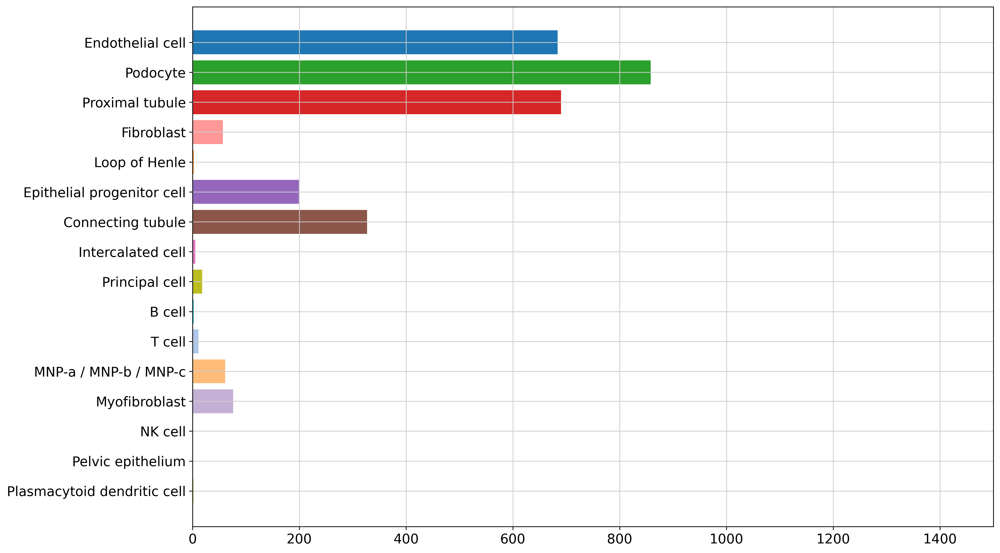

In [66]:
ct_label, ct_count = np.unique(tmp_df['NANOSTRING_simplified_celltypes'].values, return_counts=True)
ct_dct = dict(zip(ct_label, ct_count))

orders = [i for i in [
    'Endothelial cell',
    'Podocyte',
    'Proximal tubule',
    'Fibroblast',
    'Loop of Henle',
    'Epithelial progenitor cell',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell',
    'T cell',
    'MNP-a / MNP-b / MNP-c',
    'MNP-d/Tissue macrophage',
    'Myofibroblast',
    'NK cell',
    'Mast cell',
    'Pelvic epithelium',
    'Plasmacytoid dendritic cell',
] if i in ct_dct][::-1]

fig, ax = plt.subplots(figsize=(15, 10))
ax = plt.barh(orders, [ct_dct[i] for i in orders], color=[nanostring_colors[i] for i in orders])
plt.xlim(0, 1500)
plt.savefig('figures/composition_nanostring.png')
plt.show()

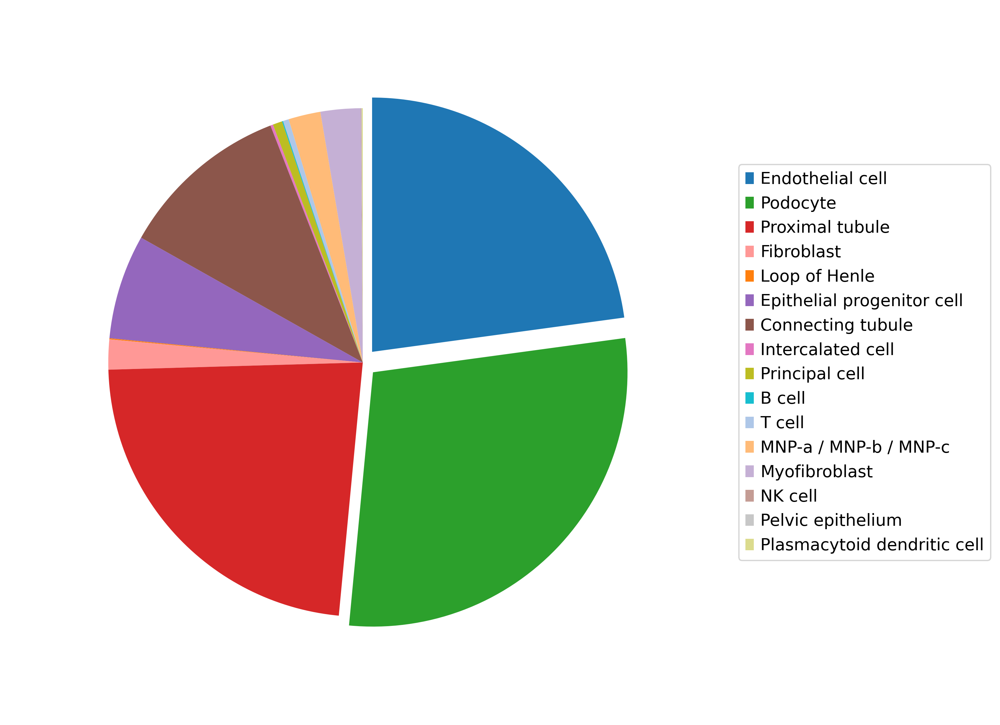

In [69]:
ct_label, ct_count = np.unique(tmp_df['NANOSTRING_simplified_celltypes'].values, return_counts=True)
ct_dct = dict(zip(ct_label, ct_count))

orders = [i for i in [
    'Endothelial cell',
    'Podocyte',
    'Proximal tubule',
    'Fibroblast',
    'Loop of Henle',
    'Epithelial progenitor cell',
    'Connecting tubule',
    'Intercalated cell',
    'Principal cell',
    'B cell',
    'T cell',
    'MNP-a / MNP-b / MNP-c',
    'MNP-d/Tissue macrophage',
    'Myofibroblast',
    'NK cell',
    'Mast cell',
    'Pelvic epithelium',
    'Plasmacytoid dendritic cell',
] if i in ct_dct][::-1]

fig, ax = plt.subplots(figsize=(20,10))
myexplode = [0] * len(ct_label)
myexplode[-1] = 0.05
myexplode[-2] = 0.05
ax = plt.pie([ct_dct[i] for i in orders], labels=None, startangle=90, explode=myexplode, colors=[nanostring_colors[i] for i in orders], radius=0.9)
plt.legend(
    loc="center right", 
    # title="NanoString Cell Types", 
    labels=orders, 
    bbox_to_anchor=(1.4, 0.5), 
    reverse=True
)
plt.savefig('figures/composition_nanostring_pie.png')
plt.show()

In [58]:
aucell_df = pd.read_csv('AUCell.tsv', sep='\t', index_col=0)

In [59]:
aucell_df.head()

,NANOSTRING_fovAnnotation,AUCell scores - Lipid metabolism,AUCell scores - Chemokine/cytokine,AUCell scores - Inflammation,AUCell scores - Angiogenesis,AUCell scores - Cell cycle proliferation,x,y
Barcodes,,,,,,,,
2_3,DKD_2-3,0.096954,0.096954,0.198430,0.489796,0.000000,49185.0,1559.0
2_5,DKD_2-3,0.486279,0.194945,0.387724,0.246389,0.487096,49549.0,1732.0
2_6,DKD_2-3,0.098022,0.295824,0.098022,0.000000,0.099372,48990.0,1692.0
2_7,DKD_2-3,0.296609,0.199058,0.097865,0.000000,0.293595,49413.0,1717.0
2_8,DKD_2-3,0.194349,0.295416,0.194349,0.000000,0.392088,48835.0,1781.0


AUCell scores - Chemokine/cytokine        Axes(0.18,0.15;0.354545x0.76)
AUCell scores - Lipid metabolism      Axes(0.605455,0.15;0.354545x0.76)
dtype: object

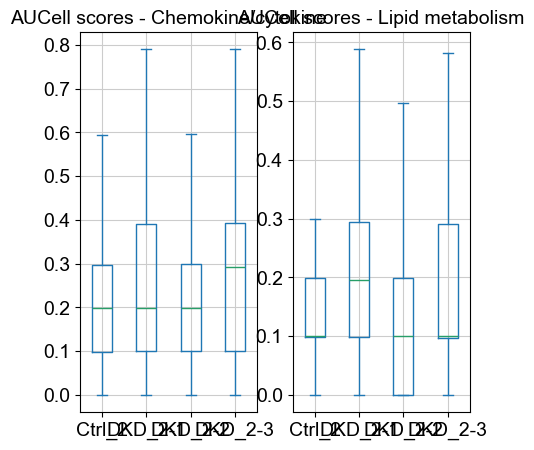

In [74]:
scanpy.set_figure_params(dpi=50, dpi_save=1000, figsize=(5, 5))
fig, ax = plt.subplots(nrows=2, ncols=2, sharex=True, sharey=True)
aucell_df.plot(kind='box', column=['AUCell scores - Lipid metabolism'], by='NANOSTRING_fovAnnotation', showfliers=False, ax=ax[0, 1])

## Compare DEG between normalization

In [20]:
total_norm_adata = ori_adata.copy()
del total_norm_adata.X
total_norm_adata.X = total_norm_adata.layers['raw']
del total_norm_adata.layers['raw']

scanpy.pp.normalize_total(total_norm_adata, target_sum=10000)
ori_adata.layers['norm_total'] = total_norm_adata.X

In [46]:
tmp_adata = ori_adata[
    ~ori_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('Ctrl_1'),
    :
]
tmp_adata = tmp_adata[
    ~tmp_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('DKD_1-3'),
    :
]

In [47]:
tmp_adata.obs['NANOSTRING_fovAnnotation'].unique()

['DKD_2-3', 'Ctrl_2']
Categories (2, object): ['Ctrl_2', 'DKD_2-3']

In [48]:
glo_idx = tmp_adata.obs['BioTuring_TP_tissue_structure'].values == 'glomerulus'
other_idx = tmp_adata.obs['BioTuring_TP_tissue_structure'].values == 'Unassigned'

### For scipy wilcox / manwhitneyu, we used normalized data

In [35]:
import scipy

In [36]:
def calc_log2fc(group_1, group_2, eps: float = 1e-9):
	n1 = group_1.shape[0]
	n2 = group_2.shape[0]
	group_1_data = group_1.data
	group_2_data = group_2.data

	group_1_mean = group_1.sum(axis=0).A[0] / n1 + eps
	group_2_mean = group_2.sum(axis=0).A[0] / n2 + eps

	group_1.data = group_1_data
	group_2.data = group_2_data
	log2fc = np.log2(group_1_mean) - np.log2(group_2_mean)

	return log2fc

In [37]:
norm_mannwhitneyu_test = scipy.stats.mannwhitneyu(
    tmp_adata.X[glo_idx, :].todense(),
    tmp_adata.X[other_idx, :].todense(),
    axis=0
)

raw_mannwhitneyu_test = scipy.stats.mannwhitneyu(
    tmp_adata.layers['raw'][glo_idx, :].todense(),
    tmp_adata.layers['raw'][other_idx, :].todense(),
    axis=0
)

norm_total_mannwhitneyu_test = scipy.stats.mannwhitneyu(
    tmp_adata.layers['norm_total'][glo_idx, :].todense(),
    tmp_adata.layers['norm_total'][other_idx, :].todense(),
    axis=0
)

In [38]:
norm_chosen_genes = np.nonzero(norm_mannwhitneyu_test.pvalue < 0.05)[0]
norm_pvalue = norm_mannwhitneyu_test.pvalue[norm_chosen_genes]
norm_fc = calc_log2fc(
    tmp_adata.X[glo_idx, :][:, norm_chosen_genes], 
    tmp_adata.X[other_idx, :][:, norm_chosen_genes]
)

raw_chosen_genes = np.nonzero(raw_mannwhitneyu_test.pvalue < 0.05)[0]
raw_pvalue =raw_mannwhitneyu_test.pvalue[raw_chosen_genes]
raw_fc = calc_log2fc(
    tmp_adata.layers['raw'][glo_idx, :][:, raw_chosen_genes], 
    tmp_adata.layers['raw'][other_idx, :][:, raw_chosen_genes]
)

norm_total_chosen_genes = np.nonzero(norm_total_mannwhitneyu_test.pvalue < 0.05)[0]
norm_total_pvalue = norm_total_mannwhitneyu_test.pvalue[norm_total_chosen_genes]
norm_total_fc = calc_log2fc(
    tmp_adata.layers['norm_total'][glo_idx, :][:, norm_total_chosen_genes], 
    tmp_adata.layers['norm_total'][other_idx, :][:, norm_total_chosen_genes]
)

In [40]:
df = pd.DataFrame({'p_value': norm_pvalue, 'fc': norm_fc}, index=tmp_adata.var_names[norm_chosen_genes])
df = df.sort_values('p_value')
df.to_csv('DEG_slide1/cell_area_norm.csv')

df = pd.DataFrame({'p_value': raw_pvalue, 'fc': raw_fc}, index=tmp_adata.var_names[raw_chosen_genes])
df = df.sort_values('p_value')
df.to_csv('DEG_slide1/raw.csv')

df = pd.DataFrame({'p_value': norm_total_pvalue, 'fc': norm_total_fc}, index=tmp_adata.var_names[norm_total_chosen_genes])
df = df.sort_values('p_value')
df.to_csv('DEG_slide1/norm_total.csv')

### For scanpy wilcoxon (rank_genes_groups), we used log1p - normalized data

In [49]:
tmp_adata.X = np.log1p(tmp_adata.X)
tmp_adata.layers['raw'] = np.log1p(tmp_adata.layers['raw'])
tmp_adata.layers['norm_total'] = np.log1p(tmp_adata.layers['norm_total'])

/tmp/ipykernel_1776181/1184961119.py:2: ImplicitModificationWarning: Setting element `.layers['raw']` of view, initializing view as actual.
  tmp_adata.layers['raw'] = np.log1p(tmp_adata.layers['raw'])


In [50]:
scanpy.tl.rank_genes_groups(tmp_adata, groupby='BioTuring_TP_tissue_structure', use_raw=False, method='wilcoxon')
norm_res = tmp_adata.uns['rank_genes_groups']

scanpy.tl.rank_genes_groups(tmp_adata, groupby='BioTuring_TP_tissue_structure', use_raw=False, layer='raw', method='wilcoxon')
raw_res = tmp_adata.uns['rank_genes_groups']

scanpy.tl.rank_genes_groups(tmp_adata, groupby='BioTuring_TP_tissue_structure', use_raw=False, layer='norm_total', method='wilcoxon')
norm_total_res = tmp_adata.uns['rank_genes_groups']

In [52]:
df = pd.DataFrame({
	'z_scores': [i[1] for i in norm_res['scores']],
	'pvals': [i[1] for i in norm_res['pvals']],
	'log2FC': [i[1] for i in norm_res['logfoldchanges']],
}, index=[i[1] for i in norm_res['names']])
df = df.iloc[
    df['pvals'].values <= 0.05,
    :
]
df = df.sort_values(by='pvals')
df.to_csv('DEG_scanpy_slide2/cell_area_norm.csv')

df = pd.DataFrame({
	'z_scores': [i[1] for i in raw_res['scores']],
	'pvals': [i[1] for i in raw_res['pvals']],
	'log2FC': [i[1] for i in raw_res['logfoldchanges']],
}, index=[i[1] for i in raw_res['names']])
df = df.iloc[
    df['pvals'].values <= 0.05,
    :
]
df = df.sort_values(by='pvals')
df.to_csv('DEG_scanpy_slide2/raw.csv')

df = pd.DataFrame({
	'z_scores': [i[1] for i in norm_total_res['scores']],
	'pvals': [i[1] for i in norm_total_res['pvals']],
	'log2FC': [i[1] for i in norm_total_res['logfoldchanges']],
}, index=[i[1] for i in norm_total_res['names']])
df = df.iloc[
    df['pvals'].values <= 0.05,
    :
]
df = df.sort_values(by='pvals')
df.to_csv('DEG_scanpy_slide2/norm_total.csv')

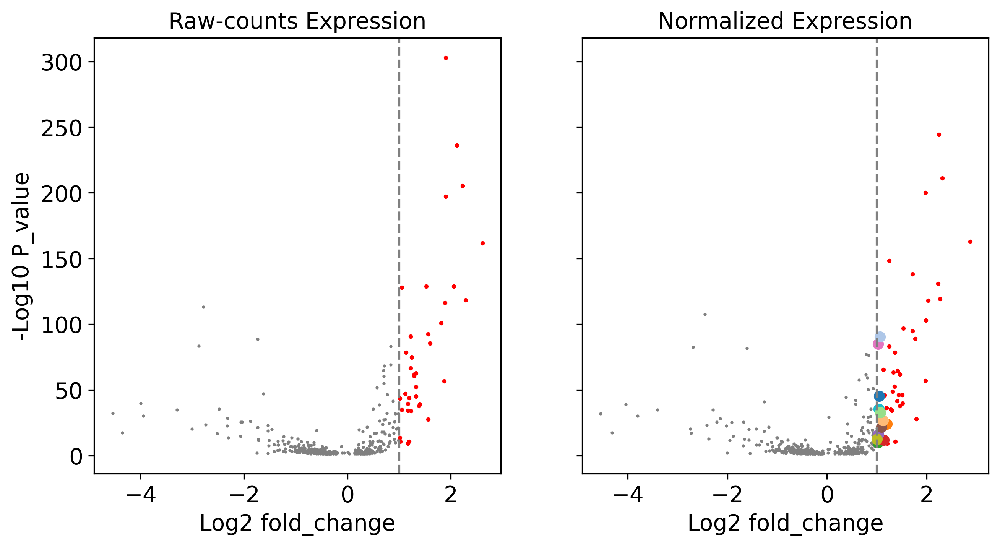

In [180]:
from matplotlib import pyplot as plt

fig, ax = plt.subplots(
    nrows=1, ncols=3, sharey=True, figsize=(10, 5)
)

ax[0].scatter(
    x=norm_fc[norm_fc < 1],
    y=norm_pvalue[norm_fc < 1],
    s=1,
    label='Down-regulated',
    color='gray'
)
ax[0].scatter(
    x=norm_fc[norm_fc >= 1],
    y=norm_pvalue[norm_fc >= 1],
    s=3,
    label='Significantly Up-regulated',
    color='red'
)

ax[0].set_xlabel('Log2 fold_change')
ax[0].axvline(1, color="grey",linestyle="--")
ax[0].grid(False)
ax[0].set_title('Cell-area Normalization')

ax[1].scatter(
    x=raw_fc[raw_fc < 1],
    y=raw_pvalue[raw_fc < 1],
    s=1,
    color='gray'
)
ax[1].scatter(
    x=raw_fc[raw_fc >= 1],
    y=raw_pvalue[raw_fc >= 1],
    s=3,
    label='Significantly Up-regulated',
    color='red'
)
ax[1].set_xlabel('Log2 fold_change')
ax[1].set_ylabel('-Log10 P_value')
ax[1].axvline(1, color="grey",linestyle="--")
ax[1].grid(False)
ax[1].set_title('Total-count Normalization')

ax[2].scatter(
    x=raw_fc[raw_fc < 1],
    y=raw_pvalue[raw_fc < 1],
    s=1,
    color='gray'
)
ax[2].scatter(
    x=raw_fc[raw_fc >= 1],
    y=raw_pvalue[raw_fc >= 1],
    s=3,
    label='Significantly Up-regulated',
    color='red'
)
ax[2].set_xlabel('Log2 fold_change')
ax[2].set_ylabel('-Log10 P_value')
ax[2].axvline(1, color="grey",linestyle="--")
ax[2].grid(False)
ax[2].set_title('Raw-counts Expression')

# plt.savefig('figures/DEG_slide2.png')
plt.show()

In [175]:
norm_chosen_genes_fc = norm_chosen_genes[norm_fc >= 1]
raw_chosen_genes_fc = raw_chosen_genes[raw_fc >= 1]

In [176]:
print(np.sum(norm_fc >= 1))
print(np.sum(raw_fc >= 1))

57
45


In [177]:
only_in_norm = ori_adata.var_names[
    norm_chosen_genes_fc[np.isin(norm_chosen_genes_fc, raw_chosen_genes_fc) == False]
]
only_in_norm

Index(['APP', 'AQP1', 'BST1', 'COL4A5', 'ESAM', 'FGFR1', 'HSPA1B', 'ICAM2',
       'KLF2', 'S100A6', 'ST6GAL1', 'TM4SF1'],
      dtype='object')

In [178]:
[np.nonzero(ori_adata.var_names == i)[0][0] for i in only_in_norm]

[55, 56, 97, 238, 340, 367, 455, 460, 578, 811, 872, 909]

In [179]:
[norm_chosen_genes.tolist().index(i) for i in [55, 56, 97, 238, 340, 367, 455, 460, 578, 811, 872, 909]]

[20, 21, 34, 104, 149, 162, 209, 211, 261, 359, 384, 401]

In [196]:
ori_adata

AnnData object with n_obs × n_vars = 78467 × 1008
    obs: 'Number of mRNA transcripts', 'Number of genes', 'Percentage of negative controls', 'BioTuring_Alexa-488_PanCK_Tumor', 'BioTuring_Alexa-546_Yellow_Immune', 'BioTuring_Alexa-594_CD298_B2M_Membrane', 'BioTuring_Alexa-647_CD45_Immune', 'BioTuring_DAPI_DNA_Nuclei', 'BioTuring_AUCell scores - kidney CD4 T', 'BioTuring_Louvain clustering (resolution=0.7)', 'BioTuring_label', 'BioTuring_sup$clust', 'BioTuring_bioturing_1st_anno', 'BioTuring louvain (on scvi-vae)', 'BioTuring_TP_tissue_structure', 'BioTuring_cell type (old)', 'NANOSTRING_fov', 'NANOSTRING_Area', 'NANOSTRING_AspectRatio', 'NANOSTRING_Width', 'NANOSTRING_Height', 'NANOSTRING_Mean.PanCK', 'NANOSTRING_Max.PanCK', 'NANOSTRING_Mean.CD68', 'NANOSTRING_Max.CD68', 'NANOSTRING_Mean.CD298_B2M', 'NANOSTRING_Max.CD298_B2M', 'NANOSTRING_Mean.CD45', 'NANOSTRING_Max.CD45', 'NANOSTRING_Mean.DAPI', 'NANOSTRING_Max.DAPI', 'NANOSTRING_Run_name', 'NANOSTRING_Slide_name', 'NANOSTRING_ISH.co

In [71]:
ori_adata.obs['NANOSTRING_fovAnnotation'].unique()

['DKD_1-3', 'Ctrl_1', 'DKD_2-3', 'Ctrl_2']
Categories (4, object): ['Ctrl_1', 'Ctrl_2', 'DKD_1-3', 'DKD_2-3']

In [77]:
tmp_adata = ori_adata[
    ~ori_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('Ctrl_1'),
    :
]
tmp_adata = tmp_adata[
    ~tmp_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('DKD_1-3'),
    :
]

In [78]:
np.unique(tmp_adata.obs['simplified_bioturing_celltypes'].values)

array(['B cell / Plasma cell', 'Connecting tubule', 'Distal tubule',
       'Endothelial cell', 'Fibroblast', 'Intercalated cell',
       'Loop of Henle', 'MNP_1', 'MNP_2', 'Myofibroblast', 'Podocyte',
       'Principal cell', 'Proximal tubule', 'T cell', 'Unassigned'],
      dtype=object)

In [81]:
immune_cell_types = ['B cell / Plasma cell', 'MNP_1', 'MNP_2', 'T cell']
colors_palette = [bioturing_color[i] for i in immune_cell_types]
conditions = ['Ctrl_2', 'DKD_2-3']

tmp_df = pd.DataFrame(
    index=conditions,
    columns=immune_cell_types
)

for con in conditions:
    tmp_ct_arr = tmp_adata.obs['simplified_bioturing_celltypes'].values[
        tmp_adata.obs['NANOSTRING_fovAnnotation'].values == con
    ]
    for ct in immune_cell_types:
        per = np.sum(tmp_ct_arr == ct) / len(tmp_ct_arr) * 100
        tmp_df.loc[
            con, ct
        ] = per

In [82]:
tmp_df

,B cell / Plasma cell,MNP_1,MNP_2,T cell
Ctrl_2,0.009289,2.071528,0.134696,0.659545
DKD_2-3,8.5105,10.265912,0.46811,6.410506


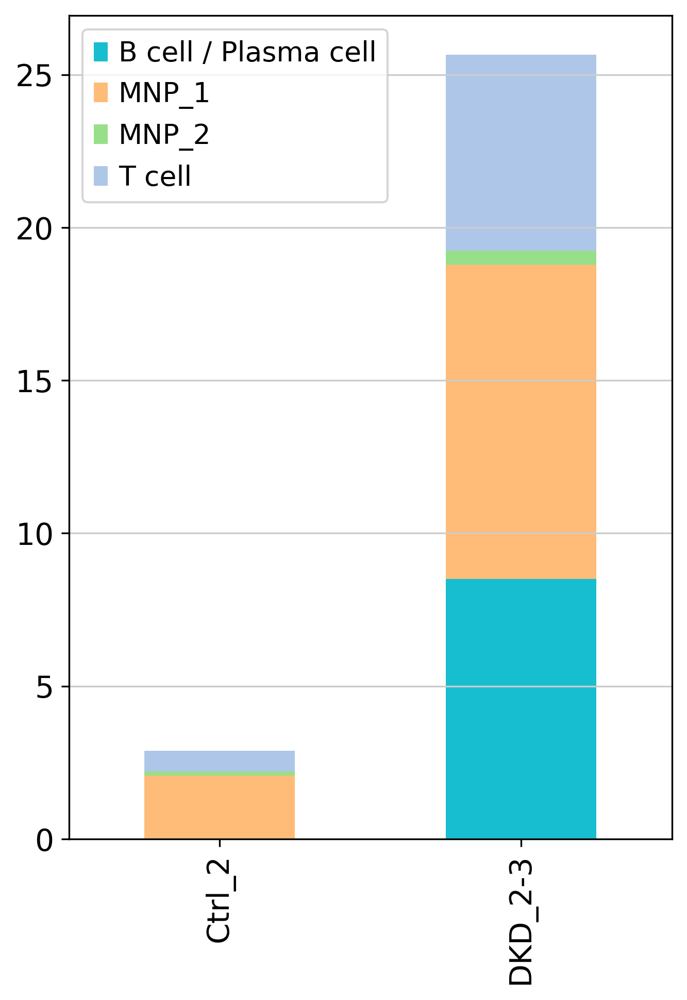

In [83]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(5, 7))
tmp_df.plot(kind='bar', stacked=True, ax=ax, color=colors_palette)
ax.grid(axis='x')
fig.savefig('figures/fig_4b_3.png')

In [229]:
tmp_adata = ori_adata[
    ~ori_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('Ctrl_2'),
    :
]
tmp_adata = tmp_adata[
    ~tmp_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('DKD_2-3'),
    :
]

In [230]:
tmp_adata

View of AnnData object with n_obs × n_vars = 34422 × 989
    obs: 'BIOTURING_700HVG_leiden_on_scvi_0.5', 'BIOTURING_700HVG_leiden_on_scvi_1.0', 'BIOTURING_700HVG_leiden_on_scvi_1.5', 'BioTuring louvain (on scvi-vae)', 'BioTuring_Number of genes', 'BioTuring_Number of mRNA transcripts', 'BioTuring_Percentage of negative controls', 'BioTuring_TP_tissue_structure', 'BioTuring_bioturing_1st_anno', 'BioTuring_cell type (old)', 'BioTuring_label', 'BioTuring_manual+prediction(ML)_celltype', 'BioTuring_manual_cell type_final', 'BioTuring_sup$clust', 'Kidney-specific model (version 1)', 'NANOSTRING_Area', 'NANOSTRING_AspectRatio', 'NANOSTRING_Commercial', 'NANOSTRING_Diversity', 'NANOSTRING_Height', 'NANOSTRING_ISH.concentration', 'NANOSTRING_Lees L Cluster 1', 'NANOSTRING_Lees L Cluster 1 truncated', 'NANOSTRING_Lees L Cluster 2', 'NANOSTRING_Lees L Cluster 2 truncated', 'NANOSTRING_Lees L Cluster 3', 'NANOSTRING_Lees L Cluster 3 truncated', 'NANOSTRING_Lees L Cluster 4', 'NANOSTRING_Lees L Cl

In [223]:
np.unique(tmp_adata.obs['simplified_bioturing_celltypes'].values)

array(['B cell / Plasma cell', 'Connecting tubule', 'Distal tubule',
       'Endothelial cell', 'Fibroblast', 'Intercalated cell',
       'Loop of Henle', 'MNP_1', 'MNP_2', 'Myofibroblast', 'Podocyte',
       'Principal cell', 'Proximal tubule', 'T cell', 'Unassigned'],
      dtype=object)

In [231]:
tmp_adata.obs_names = [x.replace('slide1a_', '') for x in tmp_adata.obs_names]
tmp_adata.obs[['simplified_bioturing_celltypes', 'NANOSTRING_simplified_celltypes']].to_csv('slide1_meta.tsv', sep='\t')

## Cytokines DEG

In [60]:
ori_adata = scanpy.read_h5ad('MANUSCRIPT_DATA_2_SLIDES.h5ad')

In [61]:
ori_adata.obs['NANOSTRING_fovAnnotation'].unique()

['DKD_1-3', 'Ctrl_1', 'DKD_2-3', 'Ctrl_2']
Categories (5, object): ['Unassigned', 'Ctrl_1', 'Ctrl_2', 'DKD_1-3', 'DKD_2-3']

In [62]:
ori_adata.obs['sample'] = 'Sample 1'
ori_adata.obs['sample'][
    ori_adata.obs['NANOSTRING_fovAnnotation'].str.count('_2')
] = 'Sample 2'

/tmp/ipykernel_1796762/1842945750.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['sample'][
/tmp/ipykernel_1796762/1842945750.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

Se

In [63]:
ori_adata.obs['condition'] = 'Control'
ori_adata.obs['condition'][
    ori_adata.obs['NANOSTRING_fovAnnotation'].str.startswith('DKD')
] = 'DKD'

/tmp/ipykernel_1796762/505607793.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.obs['condition'][
/tmp/ipykernel_1796762/505607793.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

S

In [64]:
sorted(ori_adata.obs['simplified_bioturing_celltypes'].unique().tolist())

['B cell / Plasma cell',
 'Connecting tubule',
 'Distal tubule',
 'Endothelial cell',
 'Fibroblast',
 'Intercalated cell',
 'Loop of Henle',
 'MNP_1',
 'MNP_2',
 'Myofibroblast',
 'Podocyte',
 'Principal cell',
 'Proximal tubule',
 'T cell',
 'Unassigned']

In [65]:
mnp1_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'MNP_1'
].copy()
mnp2_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'MNP_2'
].copy()
b_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'B cell / Plasma cell'
].copy()
t_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'T cell'
].copy()
proximal_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'Proximal tubule'
].copy()
podocyte_adata = ori_adata[
    ori_adata.obs['simplified_bioturing_celltypes'] == 'Podocyte'
].copy()

In [66]:
scanpy.tl.rank_genes_groups(
    mnp1_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)
scanpy.tl.rank_genes_groups(
    mnp2_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)
scanpy.tl.rank_genes_groups(
    b_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)
scanpy.tl.rank_genes_groups(
    t_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)
scanpy.tl.rank_genes_groups(
    proximal_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)
scanpy.tl.rank_genes_groups(
    podocyte_adata,
    groupby='condition',
    use_raw=False,
    method='t-test'
)

In [82]:
adj_pvals_val = mnp1_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = mnp1_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL1A', 'IL1B', 'IL6', 'IL12A', 'IL16', 'IL17A', 'IL17B', 'IL17D', 'IL18', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL1A', 'IL16', 'IL17D', 'IL18']
['IL10RA', 'IL10RB', 'IL11', 'IL13RA1', 'IL15RA', 'IL16', 'IL17D', 'IL17RA', 'IL18', 'IL1A', 'IL1R1', 'IL20', 'IL27RA', 'IL2RA', 'IL2RG', 'IL32', 'IL33', 'IL4R', 'IL6R', 'IL7']


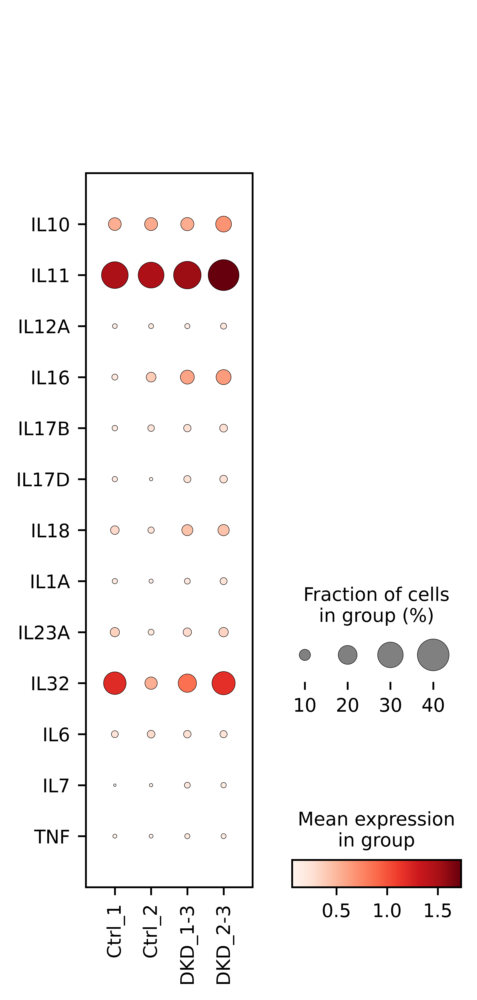

In [108]:
fig, ax = plt.subplots(figsize=(3,7), dpi=1000)
scanpy.pl.DotPlot(
    mnp1_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL10','IL11','IL12A','IL16','IL17B','IL17D','IL18','IL1A','IL23A','IL32','IL6','IL7','TNF'],
    use_raw=False,
    ax=ax,
    cmap='Reds'
).swap_axes().show()

In [84]:
set(sorted(['IL1A', 'IL16', 'IL17D', 'IL18', 'IL12A', 'IL17B', 'IL18', 'IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'TNF', 'IL10', 'IL11', 'IL32']))

{'IL10',
 'IL11',
 'IL12A',
 'IL16',
 'IL17B',
 'IL17D',
 'IL18',
 'IL1A',
 'IL23A',
 'IL32',
 'IL6',
 'IL7',
 'TNF'}

In [83]:
adj_pvals_val = mnp2_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = mnp2_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL1A', 'IL1B', 'IL6', 'IL12A', 'IL16', 'IL17A', 'IL17B', 'IL17D', 'IL18', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL12A', 'IL17B', 'IL18', 'TNF']
['IL12A', 'IL17B', 'IL17RA', 'IL18', 'IL3RA', 'IL4R', 'IL7']


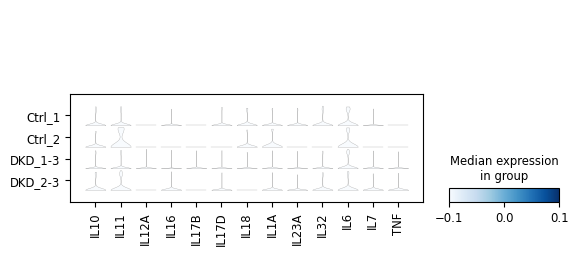

In [131]:
scanpy.pl.StackedViolin(
    mnp2_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL10','IL11','IL12A','IL16','IL17B','IL17D','IL18','IL1A','IL23A','IL32','IL6','IL7','TNF'],
    use_raw=False,
    # cmap='Reds',
    standard_scale='group'
).show()

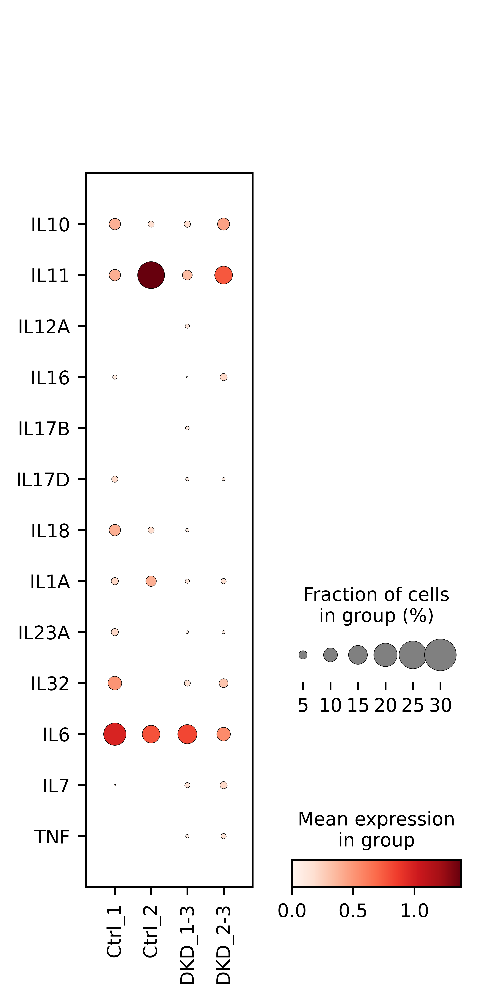

In [105]:
fig, ax = plt.subplots(figsize=(3,7), dpi=1000)
scanpy.pl.DotPlot(
    mnp2_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL10','IL11','IL12A','IL16','IL17B','IL17D','IL18','IL1A','IL23A','IL32','IL6','IL7','TNF'],
    use_raw=False,
    ax=ax,
    cmap='Reds'
).swap_axes().show()

In [80]:
adj_pvals_val = t_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = t_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'IL33', 'IL34', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'TNF']
['IL10', 'IL10RA', 'IL11', 'IL11RA', 'IL12A', 'IL12B', 'IL12RB2', 'IL15', 'IL16', 'IL17RA', 'IL1R1', 'IL20', 'IL23A', 'IL27RA', 'IL2RA', 'IL2RB', 'IL2RG', 'IL32', 'IL6R', 'IL7', 'IL7R']


In [81]:
'TNF' in all_genes

True

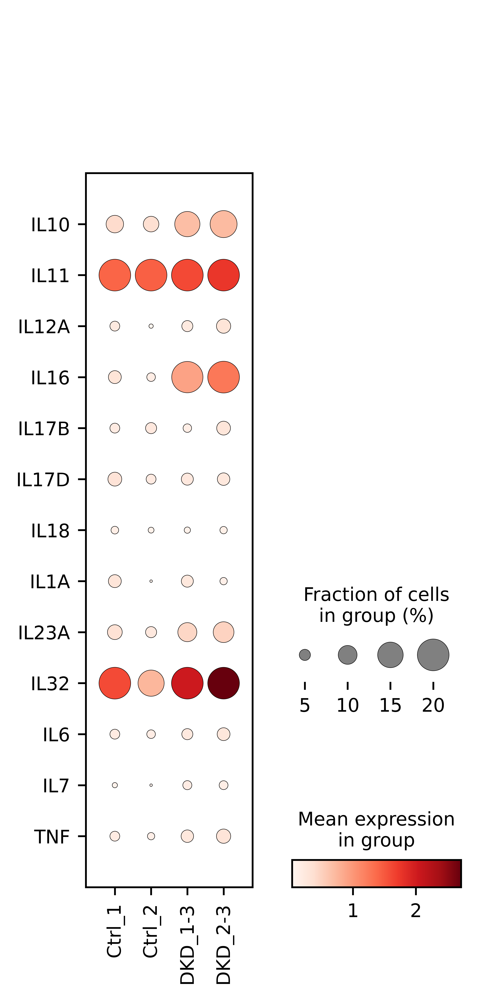

In [116]:
fig, ax = plt.subplots(figsize=(3,7), dpi=1000)
scanpy.pl.DotPlot.DEFAULT_DOT_MAX = 0.2
scanpy.pl.DotPlot(
    t_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL10','IL11','IL12A','IL16','IL17B','IL17D','IL18','IL1A','IL23A','IL32','IL6','IL7','TNF'],
    use_raw=False,
    ax=ax,
    cmap='Reds'
).swap_axes().show()
scanpy.pl.DotPlot.DEFAULT_DOT_MAX = None

In [73]:
adj_pvals_val = b_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = b_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'IL33', 'IL34', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL10', 'IL11', 'IL16', 'TNF']
['IL10', 'IL11', 'IL12A', 'IL12RB2', 'IL16', 'IL17A', 'IL18R1', 'IL20RA', 'IL22RA1', 'IL24', 'IL36G']


In [74]:
adj_pvals_val = proximal_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = proximal_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'IL33', 'IL34', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'IL33', 'IL34', 'TNF']
['IL10', 'IL10RA', 'IL10RB', 'IL11', 'IL11RA', 'IL12A', 'IL12B', 'IL12RB1', 'IL12RB2', 'IL13RA1', 'IL15', 'IL15RA', 'IL16', 'IL17A', 'IL17B', 'IL17D', 'IL17RA', 'IL17RB', 'IL17RE', 'IL18', 'IL18R1', 'IL1A', 'IL1B', 'IL1R1', 'IL1R2', 'IL1RAP', 'IL1RL1', 'IL1RN', 'IL2', 'IL20', 'IL20RA', 'IL22RA1', 'IL23A', 'IL24', 'IL27RA', 'IL2RA', 'IL2RB', 'IL2RG', 'IL32', 'IL33', 'IL34', 'IL3RA', 'IL4R', 'IL6', 'IL6R', 'IL6ST', 'IL7', 'IL7R']


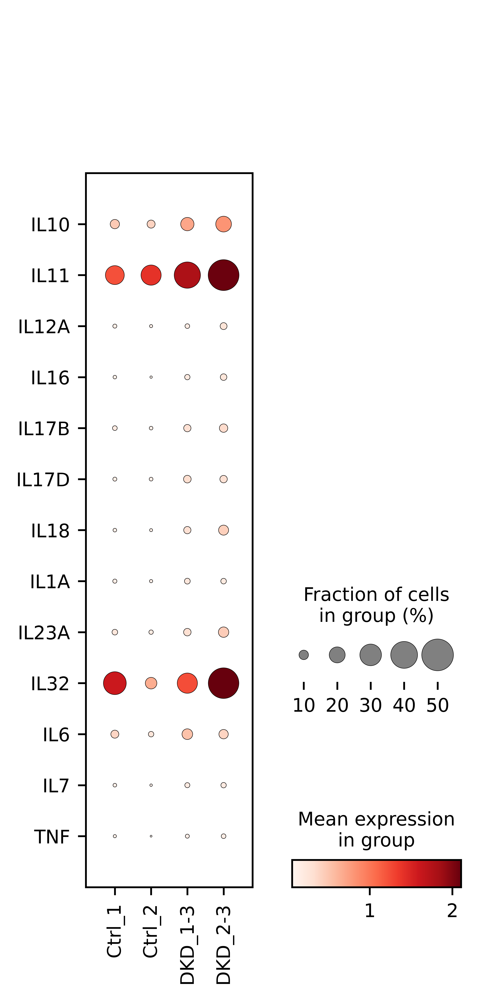

In [107]:
fig, ax = plt.subplots(figsize=(3,7), dpi=1000)
scanpy.pl.DotPlot(
    proximal_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL10','IL11','IL12A','IL16','IL17B','IL17D','IL18','IL1A','IL23A','IL32','IL6','IL7','TNF'],
    use_raw=False,
    ax=ax,
    cmap='Reds'
).swap_axes().show()

In [76]:
adj_pvals_val = podocyte_adata.uns['rank_genes_groups']['pvals']['DKD']
all_genes = podocyte_adata.uns['rank_genes_groups']['names']['DKD'][adj_pvals_val < 0.05]

testing_genes = [
    'IL6', 'IL7', 'IL10', 'IL11', 'IL16', 'IL23A', 'IL32', 'IL33', 'IL34', 'TNF'
]
print ([i for i in testing_genes if i in all_genes])
print (sorted([i for i in all_genes if i.startswith('IL')]))

['IL16']
['IL16', 'IL17RA', 'IL18R1', 'IL1RAP', 'IL36G', 'IL7R']


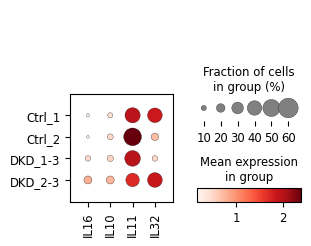

In [77]:
scanpy.pl.dotplot(
    podocyte_adata,
    groupby='NANOSTRING_fovAnnotation',
    var_names=['IL16', 'IL10', 'IL11', 'IL32'],
    use_raw=False
)

In [78]:
podocyte_adata.obs['NANOSTRING_fovAnnotation'].value_counts()

NANOSTRING_fovAnnotation
Ctrl_2     840
Ctrl_1     335
DKD_1-3     54
DKD_2-3     22
Name: count, dtype: int64